# What's Covered?

- What can be done with the Data class including:
    - Quick plotting
    - Preprocessing (filtering etc)
    - Subtraction/Addition
    - Slicing
    - Saving
- How to subclass data and why

# Standard Set-up of Examples
The standard set-up for these examples, you would not normally do this in every individual .ipynb file

In [1]:
import dat_analysis

def get_dat(datnum, raw=False, overwrite=False):
    """
    Define a simple get_dat function that knows where to load dats from and save them to

    Note: In a full setup where a path to `measurement-data` and a general save location have already been set in the dat_analysis config.toml, you can use:
        return dat_analysis.get_dat(datnum, host_name, user_name, experiment_name, raw=raw, overwrite=overwrite)
    """
    hdf_name = f"dat{datnum}{'_RAW' if raw else ''}.h5"
    return dat_analysis.get_dat_from_exp_filepath(f'experiment_dats/{hdf_name}', override_save_path=f'analyzed_dats/{hdf_name}', overwrite=overwrite)

In [2]:
dat = get_dat(6420)
dat

Dat6420 - March 3, 2023 14:35:42

# Getting Data

This is common enough that there is a shortcut to it directly in `dat_analysis`, although it is defined in `dat_analysis.analysis_tools.data`

In [3]:
from dat_analysis import Data
import numpy as np

data = Data(x=np.linspace(0, 10), data=np.sin(np.linspace(0, 10)))
print(type(data))

<class 'dat_analysis.analysis_tools.data.Data'>


To get a very quick look at what the `data` contains, just leave it at the end of a cell

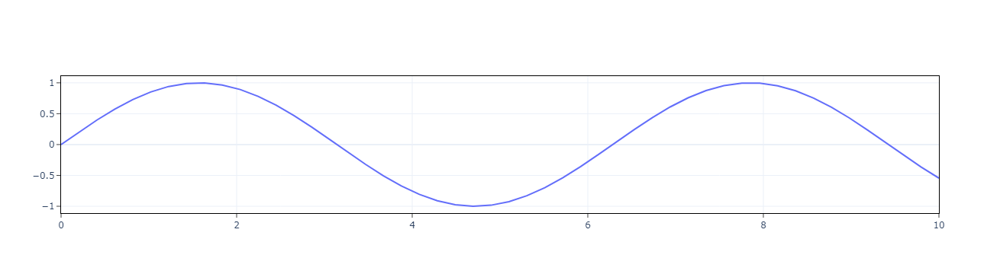

In [4]:
data

The `Data` object is basically a holder for `x`, `y`, `data`, `xerr`, `yerr`, `plot_info` which are things that are often nice to keep together

Let's demonstrate that a little here

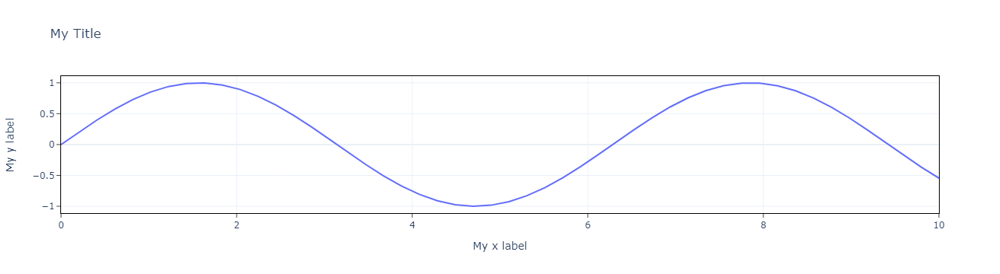

In [5]:
data.plot_info.x_label = 'My x label'
data.plot_info.y_label = 'My y label'
data.plot_info.title = 'My Title'
fig = data.plot()
fig

But, it is **MUCH** more powerful than that... Let's use some real data to demonstrate

# Examples with real data

Let's load a 2D dataset and use that for demonstrating the power of the `Data` class

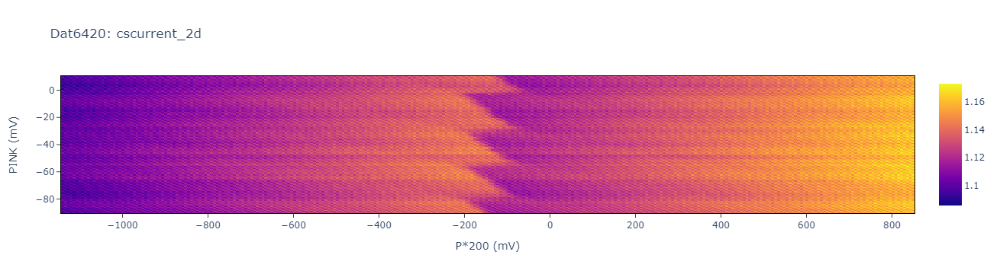

In [6]:
data = dat.get_Data('cscurrent_2d')  # this could be any data saved in the dat (dat.Data.data_keys to see what is there)
data

Immediately, we can see data that we want to work with, and we can modify this easily.

In [7]:
# data.power_spectrum(...)  

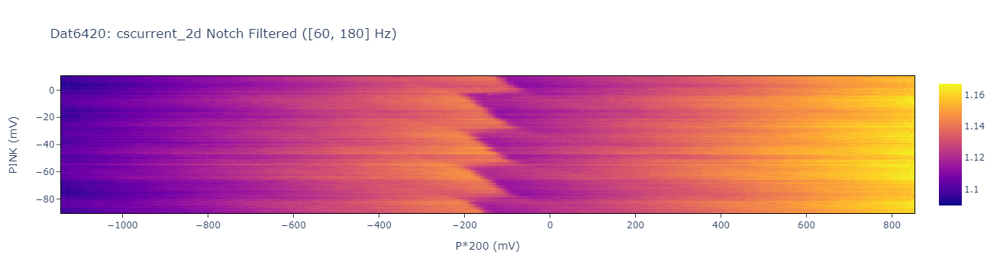

In [8]:
data.notch_filter([60, 180], Q=10, measure_freq=dat.Logs.measure_freq)

And we can chain these sorts of things together

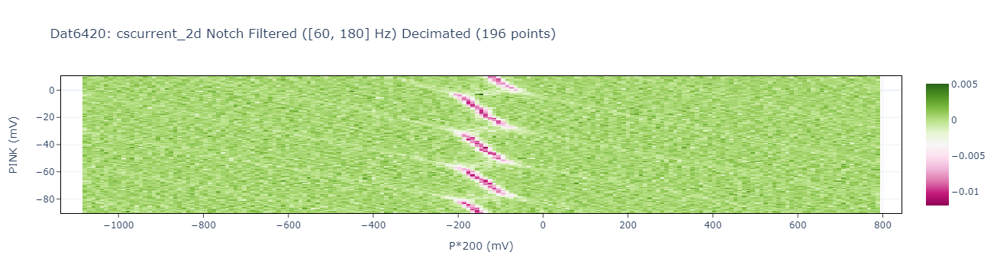

In [9]:
new_data = data.notch_filter([60, 180], Q=10, measure_freq=dat.Logs.measure_freq).decimate(numpnts=200).diff(axis=-1)
new_data

Any time you do a modification like this, you are returned a new copy of the data.

That means you can easily compare before and after, and you don't have to worry about modifying data in other places accidentally.

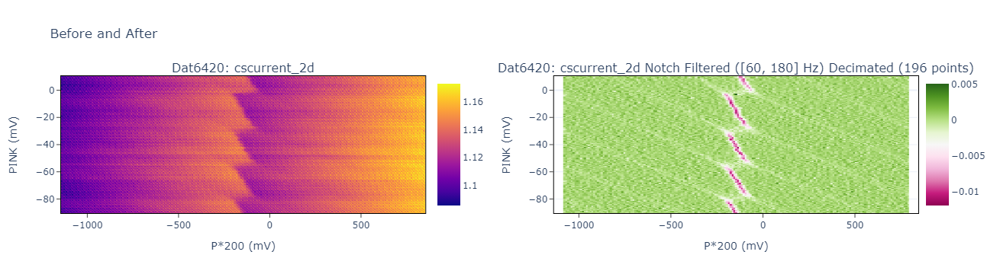

In [10]:
from dat_analysis.plotting.plotly.util import figures_to_subplots
figures_to_subplots([data.plot(), new_data.plot()], title='Before and After')

Also, a title is automatically created that let's you know what processing you have done (good for quickly putting plots in a notebook).

# Specific Examples

In [11]:
data = dat.get_Data('cscurrent_2d')  # this could be any data saved in the dat (dat.Data.data_keys to see what is there)

## .plot
As it sounds, makes a figure from the data

**Note: set `resample=False` to get the full density of datapoints, otherwise downsamples before plotting to prevent clogging the notebook**

In [12]:
fig = data.plot(resample=True)  
type(fig)

plotly.graph_objs._figure.Figure

## .get_traces
Returns just the traces that would be added to a figure (useful when plotting many 1D data into a single figure for example)

In [13]:
twod_traces = data.get_traces(max_num_pnts=1000, name='data2d')
print(type(twod_traces[0]))

oned_traces = data.mean().get_traces(name='data1d')
print(type(oned_traces[0]))

<class 'plotly.graph_objs._heatmap.Heatmap'>
<class 'plotly.graph_objs._scatter.Scatter'>


## .power_spectrum
Calculates the power spectrum of the data and returns an instance of PowerSpectrumData (which is a subclass of Data that plots slightly differently)

In [14]:
# power_spec = data.power_spectrum()

## .center
Centers data given a list of center values

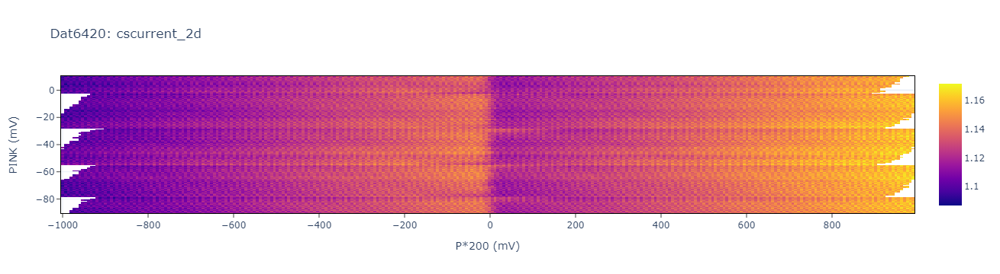

In [15]:
# Getting some example centers by finding the minimums of differentiated data
diffd = data.decimate(numpnts=200).diff()
centers = diffd.x[np.nanargmin(diffd.data, axis=1)]

# Now centering with those centers
centered_data = data.center(centers=centers)
centered_data

## .mean
Averages data in given axis (optionally after centering with provided centers)

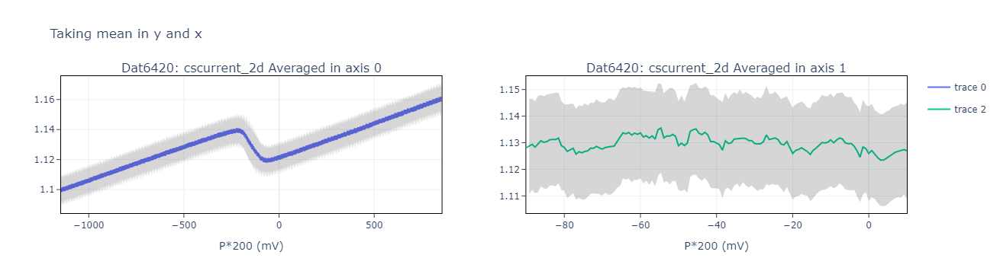

In [16]:
figures_to_subplots([data.mean(axis=0).plot(), data.mean(axis=1).plot()], title='Taking mean in y and x')

## .diff
Differentiates data in given axis

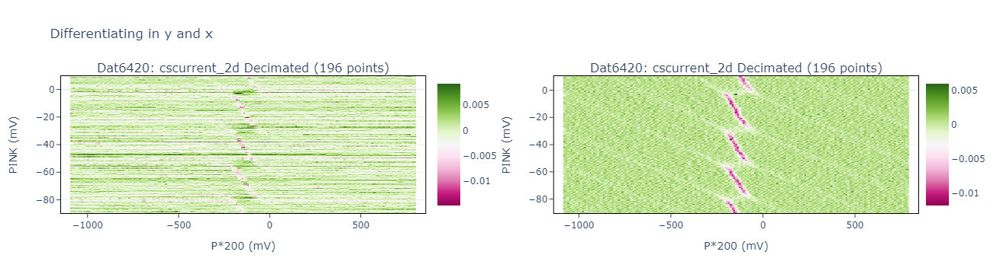

In [17]:
decimated = data.decimate(numpnts=200)
figures_to_subplots([decimated.diff(axis=0).plot(), decimated.diff(axis=1).plot()], title='Differentiating in y and x')

## .smooth
Smooths data in given axis using `scipy.signal.savgol_filter` (does not downsample)

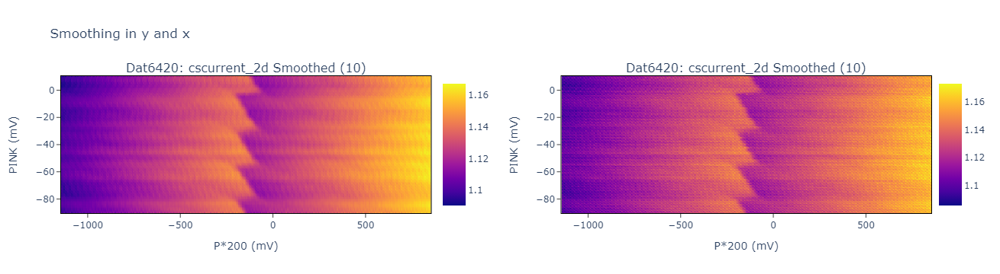

In [18]:
figures_to_subplots([data.smooth(axis=0, window_length=10).plot(), data.smooth(axis=1, window_length=10).plot()], title='Smoothing in y and x')

## .decimate
Low pass filters then downsamples data leaving `np.nan` in the edges where the lowpass filter creates artifacts. 

Note: the lowpass filter is a zero-phase filter

## .notch_filter
Notch filters given frequencies with Q factors

## .bin
Bins data (i.e. basic downsampling with averaging)

## subtract
You can subtract one instance of Data from another, and the x and y axes will be respected 
Note: the resulting Data will only include the overlap between them

## add
Same as subtracting, but addition...

## slicing
Allows slicing of Data similar to how you can slice numpy arrays, but also applies the slicing the x and y axes where necessary

## .slice_values
Allows slicing of Data based on x and y axes rather than indexes

## .save_to_txt
Saves to `.txt` file using `np.savetxt`

## .save_to_mat
Saves to `.mat` file

## .save_to_itx
Saves to `.itx` including the x and y axes, and even the x and y axis labels if present in the `Data.plot_info`